In [8]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import os
# Use relative path from current working directory
dataset_base_path = os.path.join(os.getcwd(), 'the-fake-or-real-dataset')
for dirname, _, filenames in os.walk(dataset_base_path):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/.DS_Store
/Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-norm/.DS_Store
/Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-norm/for-norm/.DS_Store
/Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-norm/for-norm/training/.DS_Store
/Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-norm/for-norm/training/real/file34190.wav_16k.wav_norm.wav_mono.wav_silence.wav
/Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-norm/for-norm/training/real/file8119.wav_16k.wav_norm.wav_mono.wav_silence.wav
/Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-norm/for-norm/training/real/file13110.wav_16k.wav_norm.wav_mono.wav_silence.wav
/Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-norm/for-norm/training/real/file12422.wav_16k.wav_norm.wav_mono.wav_silence.wav
/Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-norm/for-norm/training/real/file10493.wav_16k.wav_norm.wav_mono

# Machine Learning

In [ ]:
# Train only the LSTM model with the preprocessed data
# This cell assumes you have already run the preprocessing cells above

print("\nTraining Enhanced LSTM model...")

# Check if data exists
if 'X_train_aug' not in locals():
    print("Error: Training data not found. Please run the preprocessing cells first.")
else:
    # Define the LSTM model
    input_shape = X_train_aug.shape[1:]
    lstm_model = create_enhanced_lstm_model(input_shape)
    
    lstm_model.compile(
        optimizer=Adam(learning_rate=0.001),
        loss='categorical_crossentropy',
        metrics=['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall()]
    )
    
    # Callbacks
    reduce_lr = ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.5,
        patience=3,
        min_lr=1e-7,
        verbose=1
    )
    
    checkpoint_lstm = ModelCheckpoint(
        "original_enhanced_lstm_model.keras",
        monitor='val_accuracy',
        save_best_only=True,
        mode='max',
        verbose=1
    )
    
    early_stopping = EarlyStopping(
        monitor='val_loss',
        patience=10,
        restore_best_weights=True,
        verbose=1
    )
    
    # Train LSTM
    print("Starting LSTM training...")
    print(f"Training data shape: {X_train_aug.shape}")
    print(f"Validation data shape: {X_val_spectrograms.shape}")
    
    lstm_history = lstm_model.fit(
        X_train_aug,
        y_train_cat,
        validation_data=(X_val_spectrograms, y_val_cat),
        epochs=30,
        batch_size=64,
        callbacks=[reduce_lr, checkpoint_lstm, early_stopping],
        verbose=1
    )
    
    print("\nLSTM training completed!")
    
    # Evaluate LSTM
    print("\nEvaluating LSTM model...")
    best_lstm = tf.keras.models.load_model("original_enhanced_lstm_model.keras")
    lstm_eval = best_lstm.evaluate(X_test_spectrograms, y_test_cat, verbose=1)
    
    # Get predictions and metrics
    lstm_pred = np.argmax(best_lstm.predict(X_test_spectrograms), axis=1)
    y_test_classes = np.argmax(y_test_cat, axis=1)
    lstm_accuracy = accuracy_score(y_test_classes, lstm_pred)
    
    # Get detailed classification report
    lstm_report = classification_report(y_test_classes, lstm_pred, output_dict=True)
    
    print(f"\n{'='*50}")
    print("LSTM MODEL RESULTS")
    print(f"{'='*50}")
    print(f"Test Accuracy: {lstm_accuracy:.4f}")
    print(f"Precision: {lstm_report['weighted avg']['precision']:.4f}")
    print(f"Recall: {lstm_report['weighted avg']['recall']:.4f}")
    print(f"F1-Score: {lstm_report['weighted avg']['f1-score']:.4f}")
    
    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    lstm_cm = confusion_matrix(y_test_classes, lstm_pred)
    plt.imshow(lstm_cm, cmap='Blues')
    plt.title('LSTM Confusion Matrix')
    plt.colorbar()
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.xticks([0, 1], ['Real', 'Fake'])
    plt.yticks([0, 1], ['Real', 'Fake'])
    
    for i in range(2):
        for j in range(2):
            plt.text(j, i, f"{lstm_cm[i, j]}", ha='center', va='center',
                    color='white' if lstm_cm[i, j] > lstm_cm.max()/2 else 'black')
    
    plt.tight_layout()
    plt.show()
    
    # Plot training history
    plt.figure(figsize=(12, 4))
    
    plt.subplot(1, 2, 1)
    plt.plot(lstm_history.history['accuracy'], label='Train Accuracy')
    plt.plot(lstm_history.history['val_accuracy'], label='Val Accuracy')
    plt.title('LSTM Model Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid(True)
    
    plt.subplot(1, 2, 2)
    plt.plot(lstm_history.history['loss'], label='Train Loss')
    plt.plot(lstm_history.history['val_loss'], label='Val Loss')
    plt.title('LSTM Model Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)
    
    plt.tight_layout()
    plt.show()


In [ ]:
# Alternative: Load preprocessed data from saved files (if you saved them)
# This cell is useful if you want to train LSTM without rerunning preprocessing

import pickle

# Option to save preprocessed data (run this after preprocessing)
def save_preprocessed_data():
    data_to_save = {
        'X_train_aug': X_train_aug,
        'y_train_cat': y_train_cat,
        'X_val_spectrograms': X_val_spectrograms,
        'y_val_cat': y_val_cat,
        'X_test_spectrograms': X_test_spectrograms,
        'y_test_cat': y_test_cat
    }
    
    with open('preprocessed_data.pkl', 'wb') as f:
        pickle.dump(data_to_save, f)
    print("Preprocessed data saved to preprocessed_data.pkl")

# Option to load preprocessed data
def load_preprocessed_data():
    with open('preprocessed_data.pkl', 'rb') as f:
        data = pickle.load(f)
    
    return (data['X_train_aug'], data['y_train_cat'], 
            data['X_val_spectrograms'], data['y_val_cat'],
            data['X_test_spectrograms'], data['y_test_cat'])

# Uncomment to save data after preprocessing:
# save_preprocessed_data()

# Uncomment to load saved data:
# X_train_aug, y_train_cat, X_val_spectrograms, y_val_cat, X_test_spectrograms, y_test_cat = load_preprocessed_data()
# print("Preprocessed data loaded successfully!")


In [ ]:
# Standalone LSTM training script
# This can be run independently after you have the preprocessed data

def train_lstm_model(X_train, y_train, X_val, y_val, X_test, y_test, 
                     model_name="enhanced_lstm_model.keras", epochs=30):
    """
    Train LSTM model with the given data
    """
    print("\n" + "="*60)
    print("STANDALONE LSTM TRAINING")
    print("="*60)
    
    # Model parameters
    input_shape = X_train.shape[1:]
    print(f"Input shape: {input_shape}")
    print(f"Training samples: {X_train.shape[0]}")
    print(f"Validation samples: {X_val.shape[0]}")
    print(f"Test samples: {X_test.shape[0]}")
    
    # Create model
    print("\nCreating Enhanced LSTM model...")
    lstm_model = create_enhanced_lstm_model(input_shape)
    
    # Compile model
    lstm_model.compile(
        optimizer=Adam(learning_rate=0.001),
        loss='categorical_crossentropy',
        metrics=['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall()]
    )
    
    print(lstm_model.summary())
    
    # Callbacks
    callbacks = [
        ReduceLROnPlateau(
            monitor='val_loss',
            factor=0.5,
            patience=3,
            min_lr=1e-7,
            verbose=1
        ),
        ModelCheckpoint(
            model_name,
            monitor='val_accuracy',
            save_best_only=True,
            mode='max',
            verbose=1
        ),
        EarlyStopping(
            monitor='val_loss',
            patience=10,
            restore_best_weights=True,
            verbose=1
        )
    ]
    
    # Train model
    print(f"\nTraining LSTM for {epochs} epochs...")
    history = lstm_model.fit(
        X_train, y_train,
        validation_data=(X_val, y_val),
        epochs=epochs,
        batch_size=64,
        callbacks=callbacks,
        verbose=1
    )
    
    # Load best model and evaluate
    print(f"\nLoading best model from {model_name}...")
    best_model = tf.keras.models.load_model(model_name)
    
    # Evaluate on test set
    print("\nEvaluating on test set...")
    test_loss, test_acc, test_prec, test_rec = best_model.evaluate(X_test, y_test, verbose=1)
    
    # Get predictions
    y_pred_proba = best_model.predict(X_test)
    y_pred = np.argmax(y_pred_proba, axis=1)
    y_true = np.argmax(y_test, axis=1)
    
    # Classification report
    report = classification_report(y_true, y_pred, target_names=['Real', 'Fake'])
    print("\nClassification Report:")
    print(report)
    
    # Confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    print("\nConfusion Matrix:")
    print(cm)
    
    return history, best_model, {
        'test_accuracy': test_acc,
        'test_precision': test_prec,
        'test_recall': test_rec,
        'test_loss': test_loss,
        'confusion_matrix': cm,
        'predictions': y_pred,
        'prediction_probabilities': y_pred_proba
    }

# Example usage:
# Assuming you have the data loaded (X_train_aug, y_train_cat, etc.)
# lstm_history, lstm_model, lstm_results = train_lstm_model(
#     X_train_aug, y_train_cat,
#     X_val_spectrograms, y_val_cat,
#     X_test_spectrograms, y_test_cat,
#     model_name="my_lstm_model.keras",
#     epochs=25
# )


In [ ]:
# Quick LSTM training - Run this cell to train LSTM only
# Make sure you have run the preprocessing cells first (cells 0 and 1)

if 'X_train_aug' in locals() and 'y_train_cat' in locals():
    print("Data found! Starting LSTM training...")
    
    # Train LSTM using the standalone function
    lstm_history, lstm_model, lstm_results = train_lstm_model(
        X_train_aug, y_train_cat,
        X_val_spectrograms, y_val_cat,
        X_test_spectrograms, y_test_cat,
        model_name="original_enhanced_lstm_model.keras",
        epochs=30  # You can adjust this
    )
    
    # Visualize results
    print("\n" + "="*60)
    print("FINAL LSTM RESULTS")
    print("="*60)
    print(f"Test Accuracy: {lstm_results['test_accuracy']:.4f}")
    print(f"Test Precision: {lstm_results['test_precision']:.4f}")
    print(f"Test Recall: {lstm_results['test_recall']:.4f}")
    print(f"Test Loss: {lstm_results['test_loss']:.4f}")
    
    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    cm = lstm_results['confusion_matrix']
    plt.imshow(cm, cmap='Blues')
    plt.title('LSTM Model - Confusion Matrix')
    plt.colorbar()
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.xticks([0, 1], ['Real', 'Fake'])
    plt.yticks([0, 1], ['Real', 'Fake'])
    
    for i in range(2):
        for j in range(2):
            plt.text(j, i, f"{cm[i, j]}", ha='center', va='center',
                    color='white' if cm[i, j] > cm.max()/2 else 'black')
    
    plt.tight_layout()
    plt.show()
    
else:
    print("ERROR: Preprocessed data not found!")
    print("Please run the following cells first:")
    print("1. Cell 0 - Import libraries and define functions")
    print("2. Cell 1 - Main execution (preprocessing and data loading)")
    print("\nOr load saved data using the load_preprocessed_data() function in cell 3")


✅ Part 1: Data Preprocessing
Tasks:

Remove 0-byte files

Remove duplicates

Load & zero-pad signals to 16,000 samples

In [1]:
import os
import librosa
import numpy as np
import hashlib
from tqdm import tqdm

def compute_md5(file_path):
    with open(file_path, 'rb') as f:
        return hashlib.md5(f.read()).hexdigest()

def load_and_pad(file_path, sr=16000):
    try:
        y, _ = librosa.load(file_path, sr=sr)
        if len(y) < sr:
            y = np.pad(y, (0, sr - len(y)))
        return y
    except:
        return None

def preprocess_audio_dir(base_path):
    all_audio = []
    all_labels = []
    seen_hashes = set()

    for label_name in ['real', 'fake']:
        label_dir = os.path.join(base_path, label_name)
        label = 0 if label_name == 'real' else 1

        for file in tqdm(os.listdir(label_dir), desc=f"Processing {label_name}"):
            path = os.path.join(label_dir, file)
            if os.path.getsize(path) == 0:
                continue
            file_hash = compute_md5(path)
            if file_hash in seen_hashes:
                continue
            seen_hashes.add(file_hash)

            y = load_and_pad(path)
            if y is None:
                continue

            all_audio.append(y)
            all_labels.append(label)

    return all_audio, all_labels


✅ Part 2: Feature Extraction (MFCC + Standardization)

In [2]:
from sklearn.preprocessing import StandardScaler

def extract_mfcc_features(audio_list, sr=16000, n_mfcc=40):
    mfcc_features = []
    for y in tqdm(audio_list, desc="Extracting MFCCs"):
        mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc)
        mfcc_mean = np.mean(mfcc.T, axis=0)
        mfcc_features.append(mfcc_mean)
    return np.array(mfcc_features)

def normalize_features(X_train, X_val, X_test):
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_val = scaler.transform(X_val)
    X_test = scaler.transform(X_test)
    return X_train, X_val, X_test, scaler


✅ Part 3: Classification Models (Train & Predict)

In [3]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier

def train_models(X_train, y_train):
    models = {
        "Random Forest": RandomForestClassifier(),
        "SVM": SVC(probability=True),
        "MLP": MLPClassifier(hidden_layer_sizes=(100,), max_iter=500),
        "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric='logloss')
    }

    trained = {}
    for name, model in models.items():
        model.fit(X_train, y_train)
        trained[name] = model
    return trained


✅ Part 4: Evaluate on All 4 Datasets
You’ll loop over 4 dataset folders:

for-2seconds

for-norm

for-original

for-rerec

In [4]:
from sklearn.metrics import accuracy_score, classification_report

def evaluate_models(models, X_test, y_test):
    results = {}
    for name, model in models.items():
        y_pred = model.predict(X_test)
        acc = accuracy_score(y_test, y_pred)
        report = classification_report(y_test, y_pred, output_dict=True)
        results[name] = {
            "accuracy": acc,
            "precision": report['weighted avg']['precision'],
            "recall": report['weighted avg']['recall'],
            "f1": report['weighted avg']['f1-score']
        }
    return results


✅ Part 5: Compare All Models Across Datasets

In [5]:
import pandas as pd
import joblib

# 📁 Dataset paths (using relative paths for portability)
base_path = os.path.join(os.getcwd(), 'the-fake-or-real-dataset')
dataset_dirs = {
    "2seconds": os.path.join(base_path, "for-2sec", "for-2seconds"),
    "norm": os.path.join(base_path, "for-norm", "for-norm"),
    "original": os.path.join(base_path, "for-original", "for-original"),
    "rerec": os.path.join(base_path, "for-rerec", "for-rerecorded")
}

#def compare_all_datasets(dataset_dirs, base_path):
all_results = {}

for name, dataset_dir in dataset_dirs.items():
    train_path = os.path.join(dataset_dir, 'training')
    val_path = os.path.join(dataset_dir, 'validation')
    test_path = os.path.join(dataset_dir, 'testing')

    global y_train 
    global y_test
    X_train_raw, y_train = preprocess_audio_dir(train_path)
    X_val_raw, y_val = preprocess_audio_dir(val_path)
    X_test_raw, y_test = preprocess_audio_dir(test_path)

    global X_train
    global X_test
    X_train = extract_mfcc_features(X_train_raw)
    X_val = extract_mfcc_features(X_val_raw)
    X_test = extract_mfcc_features(X_test_raw)

    X_train, X_val, X_test, _ = normalize_features(X_train, X_val, X_test)
    global models
    models = train_models(X_train, y_train)

    # 🔽 Save each model to disk
    for model_name, model in models.items():
        filename = f"{name}_{model_name.replace(' ', '_')}.pkl"
        joblib.dump(model, filename)
        print(f"Saved model: {filename}")
        
    results = evaluate_models(models, X_test, y_test)
    all_results[name] = results



results = all_results

# Print as DataFrame
final_df = pd.DataFrame({ds: res for ds, res in results.items()}).T
display(final_df)


Extracting MFCCs: 100%|██████████| 816/816 [00:06<00:00, 117.96it/s]


Saved model: rerec_Random_Forest.pkl
Saved model: rerec_SVM.pkl
Saved model: rerec_MLP.pkl
Saved model: rerec_XGBoost.pkl


,Random Forest,SVM,MLP,XGBoost
rerec,"{'accuracy': 0.6973039215686274, 'precision': ...","{'accuracy': 0.7818627450980392, 'precision': ...","{'accuracy': 0.7622549019607843, 'precision': ...","{'accuracy': 0.741421568627451, 'precision': 0..."


In [6]:
# Flatten nested dictionary into a long-form DataFrame
flat_results = []

for dataset, model_metrics in results.items():
    for model_name, metrics in model_metrics.items():
        result_row = {
            "Dataset": dataset,
            "Model": model_name,
            "Accuracy": metrics["accuracy"],
            "Precision": metrics["precision"],
            "Recall": metrics["recall"],
            "F1 Score": metrics["f1"]
        }
        flat_results.append(result_row)

# Save and display the results
results_df = pd.DataFrame(flat_results)
results_df.to_csv("model_evaluation_results.csv", index=False)

print("\n📄 Model Evaluation Results:")
display(results_df)



📄 Model Evaluation Results:


,Dataset,Model,Accuracy,Precision,Recall,F1 Score
0,rerec,Random Forest,0.697304,0.755717,0.697304,0.678971
1,rerec,SVM,0.781863,0.844524,0.781863,0.771472
2,rerec,MLP,0.762255,0.811339,0.762255,0.752500
3,rerec,XGBoost,0.741422,0.795850,0.741422,0.728955


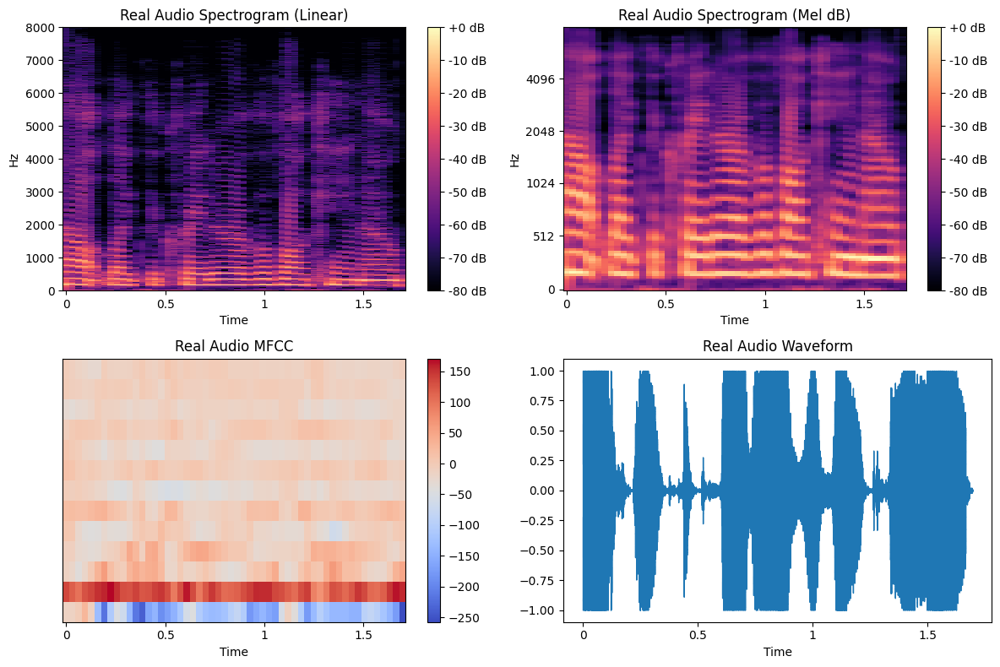

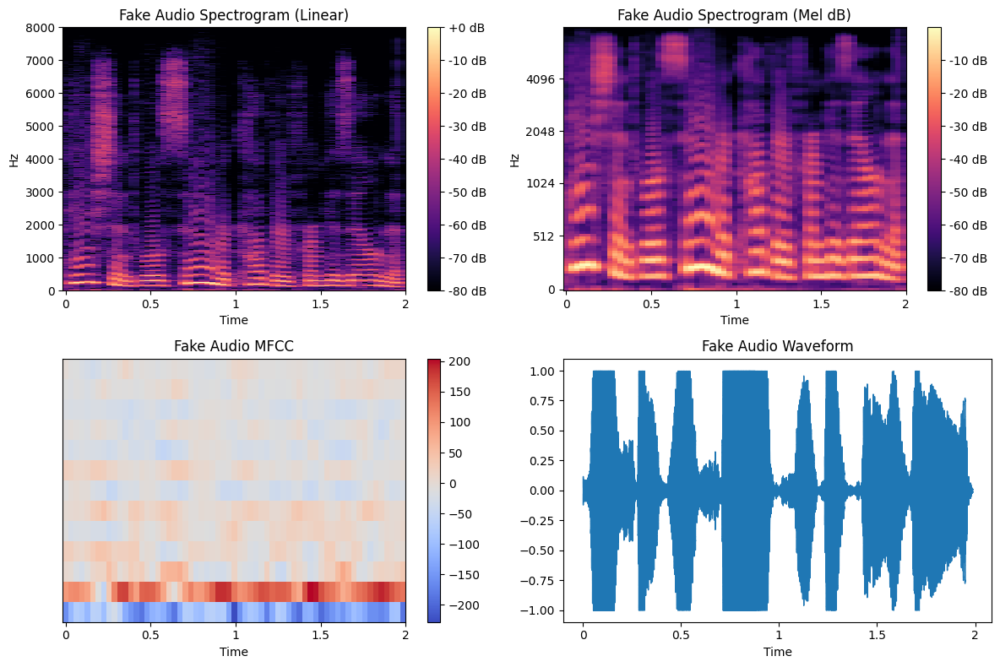

In [7]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

def plot_audio_spectrograms(audio_path, title_prefix=''):
    # Load audio
    y, sr = librosa.load(audio_path, sr=None)

    # Compute spectrogram (linear)
    D = np.abs(librosa.stft(y))

    # Convert to dB scale
    DB = librosa.amplitude_to_db(D, ref=np.max)

    # Compute log-mel spectrogram
    mel_spect = librosa.feature.melspectrogram(y=y, sr=sr)
    mel_db = librosa.power_to_db(mel_spect, ref=np.max)

    # Plot
    plt.figure(figsize=(12, 8))

    # Linear spectrogram
    plt.subplot(2, 2, 1)
    librosa.display.specshow(DB, sr=sr, x_axis='time', y_axis='linear')
    plt.title(f'{title_prefix} Spectrogram (Linear)')
    plt.colorbar(format='%+2.0f dB')

    # Log-mel spectrogram
    plt.subplot(2, 2, 2)
    librosa.display.specshow(mel_db, sr=sr, x_axis='time', y_axis='mel')
    plt.title(f'{title_prefix} Spectrogram (Mel dB)')
    plt.colorbar(format='%+2.0f dB')

    # MFCC
    mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)
    plt.subplot(2, 2, 3)
    librosa.display.specshow(mfccs, x_axis='time', sr=sr)
    plt.title(f'{title_prefix} MFCC')
    plt.colorbar()

    # Waveform
    plt.subplot(2, 2, 4)
    librosa.display.waveshow(y, sr=sr)
    plt.title(f'{title_prefix} Waveform')

    plt.tight_layout()
    plt.show()

# Use relative paths for sample audio files
sample_real_path = os.path.join(os.getcwd(), "the-fake-or-real-dataset", "for-rerec", "for-rerecorded", "testing", "real", "recording13532.wav_norm_mono.wav")
sample_fake_path = os.path.join(os.getcwd(), "the-fake-or-real-dataset", "for-rerec", "for-rerecorded", "testing", "fake", "recording13014.wav_norm_mono.wav")

plot_audio_spectrograms(sample_real_path, title_prefix="Real Audio")
plot_audio_spectrograms(sample_fake_path, title_prefix="Fake Audio")



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score, log_loss
from sklearn.preprocessing import LabelBinarizer

# Initialize model with warm_start=True to continue training over epochs
model = MLPClassifier(hidden_layer_sizes=(100,), max_iter=1, warm_start=True, random_state=42)

# Prepare one-hot labels for log loss
lb = LabelBinarizer()
y_train_bin = lb.fit_transform(y_train)
y_test_bin = lb.transform(y_test)

# Lists to store accuracy and loss values
train_acc, val_acc = [], []
train_loss, val_loss = [], []

n_epochs = 50

for epoch in range(n_epochs):
    model.fit(X_train, y_train)  # Continues training from previous weights

    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)
    
    y_train_proba = model.predict_proba(X_train)
    y_test_proba = model.predict_proba(X_test)

    # Accuracy
    train_acc.append(accuracy_score(y_train, y_train_pred))
    val_acc.append(accuracy_score(y_test, y_test_pred))

    # Loss
    train_loss.append(log_loss(y_train_bin, y_train_proba))
    val_loss.append(log_loss(y_test_bin, y_test_proba))

# Plotting
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.plot(train_acc, label="Train Accuracy")
plt.plot(val_acc, label="Validation Accuracy")
plt.title("(a) Model Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy Value")
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(train_loss, label="Train Loss")
plt.plot(val_loss, label="Validation Loss")
plt.title("(b) Model Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss Value")
plt.legend()

plt.tight_layout()
plt.show()


# Hyper Paramterization

In [9]:
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import uniform, randint


import pandas as pd
import joblib

# 📁 Dataset paths (using relative paths for portability)
base_path = os.path.join(os.getcwd(), 'the-fake-or-real-dataset')
dataset_dirs = {
    "2seconds": os.path.join(base_path, "for-2sec", "for-2seconds"),
    "norm": os.path.join(base_path, "for-norm", "for-norm"),
    "original": os.path.join(base_path, "for-original", "for-original"),
    "rerec": os.path.join(base_path, "for-rerec", "for-rerecorded")
}

#def compare_all_datasets(dataset_dirs, base_path):
all_results = []

for name, dataset_dir in dataset_dirs.items():
    train_path = os.path.join(dataset_dir, 'training')
    val_path = os.path.join(dataset_dir, 'validation')
    test_path = os.path.join(dataset_dir, 'testing')

    X_train_raw, y_train = preprocess_audio_dir(train_path)
    X_val_raw, y_val = preprocess_audio_dir(val_path)
    X_test_raw, y_test = preprocess_audio_dir(test_path)

    X_train = extract_mfcc_features(X_train_raw)
    X_val = extract_mfcc_features(X_val_raw)
    X_test = extract_mfcc_features(X_test_raw)

    X_train, X_val, X_test, _ = normalize_features(X_train, X_val, X_test)

    param_dist = {
        'hidden_layer_sizes': [(128,), (64, 32), (128, 64, 32)],
        'activation': ['relu', 'tanh'],
        'solver': ['adam'],
        'alpha': uniform(1e-5, 1e-2),  # L2 regularization
        'learning_rate_init': uniform(1e-4, 1e-2),
        'batch_size': [32, 64, 128],
        'learning_rate': ['constant', 'adaptive'],
        'max_iter': [500]
    }

    mlp = MLPClassifier(random_state=42)

    random_search = RandomizedSearchCV(
        mlp,
        param_distributions=param_dist,
        n_iter=30,
        cv=3,
        scoring='accuracy',
        n_jobs=-1,
        verbose=2
    )

    random_search.fit(X_train, y_train)
    print("Best params:", random_search.best_params_)
    y_pred = random_search.best_estimator_.predict(X_test)

    # Calculate accuracy
    from sklearn.metrics import accuracy_score
    test_accuracy = accuracy_score(y_test, y_pred)

    print("Test accuracy:", test_accuracy)
    all_results.append([name,test_accuracy])



Extracting MFCCs: 100%|██████████| 816/816 [00:04<00:00, 194.40it/s]


Fitting 3 folds for each of 30 candidates, totalling 90 fits
Best params: {'activation': 'relu', 'alpha': 0.0006588416215095006, 'batch_size': 128, 'hidden_layer_sizes': (128, 64, 32), 'learning_rate': 'constant', 'learning_rate_init': 0.008752168275567039, 'max_iter': 500, 'solver': 'adam'}
Test accuracy: 0.8590686274509803


In [10]:
print("Best params:", random_search.best_params_)

Best params: {'activation': 'relu', 'alpha': 0.0006588416215095006, 'batch_size': 128, 'hidden_layer_sizes': (128, 64, 32), 'learning_rate': 'constant', 'learning_rate_init': 0.008752168275567039, 'max_iter': 500, 'solver': 'adam'}


In [11]:
# Predict on test data
y_pred = random_search.best_estimator_.predict(X_test)

# Calculate accuracy
from sklearn.metrics import accuracy_score
test_accuracy = accuracy_score(y_test, y_pred)

print("Test accuracy:", test_accuracy)

Test accuracy: 0.8590686274509803


# Deep Learning

In [10]:
import os
import librosa
import numpy as np
import hashlib
import matplotlib.pyplot as plt
from tqdm import tqdm
import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D, LSTM, Input
from tensorflow.keras.applications import VGG16
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import pandas as pd
import joblib

# Preprocessing functions (reusing your existing code)
def compute_md5(file_path):
    with open(file_path, 'rb') as f:
        return hashlib.md5(f.read()).hexdigest()

def load_and_pad(file_path, sr=16000):
    try:
        y, _ = librosa.load(file_path, sr=sr)
        if len(y) < sr:
            y = np.pad(y, (0, sr - len(y)))
        return y
    except:
        return None

def preprocess_audio_dir(base_path):
    all_audio = []
    all_labels = []
    seen_hashes = set()
    for label_name in ['real', 'fake']:
        label_dir = os.path.join(base_path, label_name)
        label = 0 if label_name == 'real' else 1
        for file in tqdm(os.listdir(label_dir), desc=f"Processing {label_name}"):
            path = os.path.join(label_dir, file)
            if os.path.getsize(path) == 0:
                continue
            file_hash = compute_md5(path)
            if file_hash in seen_hashes:
                continue
            seen_hashes.add(file_hash)
            y = load_and_pad(path)
            if y is None:
                continue
            all_audio.append(y)
            all_labels.append(label)
    return all_audio, all_labels

# Enhanced feature extraction for deep learning (generating spectrograms)
def extract_mfcc_spectrograms(audio_list, sr=16000, n_mfcc=40):
    """Extract MFCC spectrograms for deep learning models"""
    spectrograms = []
    for y in tqdm(audio_list, desc="Extracting MFCC Spectrograms"):
        mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc)
        # Normalize mfcc features per audio file
        mfcc = (mfcc - np.mean(mfcc)) / (np.std(mfcc) + 1e-8)
        # Pad or trim to fixed size (e.g., 40 x 64)
        if mfcc.shape[1] < 64:
            pad_width = 64 - mfcc.shape[1]
            mfcc = np.pad(mfcc, ((0, 0), (0, pad_width)))
        else:
            mfcc = mfcc[:, :64]
        spectrograms.append(mfcc)
    
    # Convert to numpy array and reshape for CNN (add channel dimension)
    spectrograms = np.array(spectrograms)
    spectrograms = np.expand_dims(spectrograms, axis=-1)  # Shape: (n_samples, n_mfcc, time_steps, 1)
    return spectrograms

# Create VGG16-based model for deepfake detection
def create_vgg16_model(input_shape):
    """Create a VGG16-based transfer learning model"""
    # Create a base model from VGG16 without the top layer
    base_model = VGG16(weights='imagenet', include_top=False, input_shape=(64, 64, 3))
    
    # Freeze the base model layers
    for layer in base_model.layers:
        layer.trainable = False
    
    # Create new model
    inputs = Input(shape=input_shape)
    
    # Convert grayscale to 3-channel (if input is grayscale)
    if input_shape[-1] == 1:
        x = tf.keras.layers.Conv2D(3, (1, 1), padding='same')(inputs)
    else:
        x = inputs
    
    # Resize to 64x64 if needed
    x = tf.keras.layers.Resizing(64, 64)(x)
    
    # Pass through the VGG16 model
    x = base_model(x)
    
    # Add classification layers
    x = Flatten()(x)
    x = Dense(256, activation='relu')(x)
    x = Dropout(0.5)(x)
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.3)(x)
    outputs = Dense(2, activation='softmax')(x)
    
    # Create the model
    model = Model(inputs=inputs, outputs=outputs)
    
    # Compile the model
    model.compile(
        optimizer='adam',
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )
    
    return model

# Create LSTM model for deepfake detection
def create_lstm_model(input_shape):
    """Create an LSTM model for MFCC sequence analysis"""
    # Reshape input to be suitable for LSTM (samples, time steps, features)
    lstm_input_shape = (input_shape[1], input_shape[0])  # (time_steps, features)
    
    model = Sequential([
        Input(shape=input_shape),
        tf.keras.layers.Reshape(lstm_input_shape),
        LSTM(128, return_sequences=True),
        Dropout(0.2),
        LSTM(64),
        Dropout(0.2),
        Dense(32, activation='relu'),
        Dense(2, activation='softmax')
    ])
    
    # Compile the model
    model.compile(
        optimizer='adam',
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )
    
    return model

# Data preparation for VGG16
def prepare_data_for_dl(X_spectrograms, y_labels):
    """Prepare data for deep learning models"""
    # Convert labels to categorical
    y_categorical = to_categorical(y_labels, num_classes=2)
    
    return X_spectrograms, y_categorical

# Main execution
if __name__ == "__main__":
    # Dataset paths (using relative paths for portability)
    base_path = os.path.join(os.getcwd(), 'the-fake-or-real-dataset')
    dataset_dirs = {
        #"2seconds": os.path.join(base_path, "for-2sec", "for-2seconds"),
        #"norm": os.path.join(base_path, "for-norm", "for-norm"),
        "original": os.path.join(base_path, "for-original", "for-original"),
       # "rerec": os.path.join(base_path, "for-rerec", "for-rerecorded")
    }
    
    all_results = {}
    
    for name, dataset_dir in dataset_dirs.items():
        print(f"Processing dataset: {name}")
        
        # Load data from directories
        train_path = os.path.join(dataset_dir, 'training')
        val_path = os.path.join(dataset_dir, 'validation')
        test_path = os.path.join(dataset_dir, 'testing')
        
        X_train_raw, y_train = preprocess_audio_dir(train_path)
        X_val_raw, y_val = preprocess_audio_dir(val_path)
        X_test_raw, y_test = preprocess_audio_dir(test_path)
        
        # Extract MFCC spectrograms for deep learning
        X_train_spectrograms = extract_mfcc_spectrograms(X_train_raw)
        X_val_spectrograms = extract_mfcc_spectrograms(X_val_raw)
        X_test_spectrograms = extract_mfcc_spectrograms(X_test_raw)
        
        # Prepare data for deep learning
        X_train_dl, y_train_dl = prepare_data_for_dl(X_train_spectrograms, y_train)
        X_val_dl, y_val_dl = prepare_data_for_dl(X_val_spectrograms, y_val)
        X_test_dl, y_test_dl = prepare_data_for_dl(X_test_spectrograms, y_test)
                # Set up callbacks
        checkpoint_vgg = ModelCheckpoint(
            f"{name}_vgg16_model.keras",  # Using the .keras extension
            monitor='val_accuracy',
            save_best_only=True,
            mode='max',
            verbose=1
        )
        
        checkpoint_lstm = ModelCheckpoint(
            f"{name}_lstm_model.keras",  # Change this extension too
            monitor='val_accuracy',
            save_best_only=True,
            mode='max',
            verbose=1
        )
        
        early_stopping = EarlyStopping(
            monitor='val_loss',
            patience=5,
            restore_best_weights=True
        )
        
        # Create and train VGG16 model
        print("Training VGG16 model...")
        input_shape = X_train_spectrograms.shape[1:]
        vgg16_model = create_vgg16_model(input_shape)
        
        vgg16_history = vgg16_model.fit(
            X_train_dl,
            y_train_dl,
            validation_data=(X_val_dl, y_val_dl),
            epochs=20,
            batch_size=32,
            callbacks=[checkpoint_vgg, early_stopping]
        )
        
        # Create and train LSTM model
        print("Training LSTM model...")
        lstm_model = create_lstm_model(input_shape)
        
        lstm_history = lstm_model.fit(
            X_train_dl,
            y_train_dl,
            validation_data=(X_val_dl, y_val_dl),
            epochs=20,
            batch_size=32,
            callbacks=[checkpoint_lstm, early_stopping]
        )
        
        # Evaluate models
        vgg16_eval = vgg16_model.evaluate(X_test_dl, y_test_dl)
        lstm_eval = lstm_model.evaluate(X_test_dl, y_test_dl)
        
        # Get predictions
        vgg16_pred = np.argmax(vgg16_model.predict(X_test_dl), axis=1)
        lstm_pred = np.argmax(lstm_model.predict(X_test_dl), axis=1)
        y_test_classes = np.argmax(y_test_dl, axis=1)
        
        # Calculate metrics
        vgg16_accuracy = accuracy_score(y_test_classes, vgg16_pred)
        lstm_accuracy = accuracy_score(y_test_classes, lstm_pred)
        
        vgg16_report = classification_report(y_test_classes, vgg16_pred, output_dict=True)
        lstm_report = classification_report(y_test_classes, lstm_pred, output_dict=True)
        
        # Store results
        results = {
            "VGG16": {
                "accuracy": vgg16_accuracy,
                "precision": vgg16_report['weighted avg']['precision'],
                "recall": vgg16_report['weighted avg']['recall'],
                "f1": vgg16_report['weighted avg']['f1-score']
            },
            "LSTM": {
                "accuracy": lstm_accuracy,
                "precision": lstm_report['weighted avg']['precision'],
                "recall": lstm_report['weighted avg']['recall'],
                "f1": lstm_report['weighted avg']['f1-score']
            }
        }
        
        all_results[name] = results
        
        # Plot training history
        plt.figure(figsize=(12, 4))
        
        plt.subplot(1, 2, 1)
        plt.plot(vgg16_history.history['accuracy'], label='Train Accuracy')
        plt.plot(vgg16_history.history['val_accuracy'], label='Validation Accuracy')
        plt.title(f'VGG16 Model Accuracy - {name}')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()
        
        plt.subplot(1, 2, 2)
        plt.plot(lstm_history.history['accuracy'], label='Train Accuracy')
        plt.plot(lstm_history.history['val_accuracy'], label='Validation Accuracy')
        plt.title(f'LSTM Model Accuracy - {name}')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()
        
        plt.tight_layout()
        plt.savefig(f"{name}_training_history.png")
        plt.close()
        
        # Plot confusion matrices
        plt.figure(figsize=(12, 5))
        
        plt.subplot(1, 2, 1)
        vgg16_cm = confusion_matrix(y_test_classes, vgg16_pred)
        plt.imshow(vgg16_cm, cmap='Blues')
        plt.title(f'VGG16 Confusion Matrix - {name}')
        plt.colorbar()
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.xticks([0, 1], ['Real', 'Fake'])
        plt.yticks([0, 1], ['Real', 'Fake'])
        
        for i in range(2):
            for j in range(2):
                plt.text(j, i, f"{vgg16_cm[i, j]}", ha='center', va='center')
        
        plt.subplot(1, 2, 2)
        lstm_cm = confusion_matrix(y_test_classes, lstm_pred)
        plt.imshow(lstm_cm, cmap='Blues')
        plt.title(f'LSTM Confusion Matrix - {name}')
        plt.colorbar()
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.xticks([0, 1], ['Real', 'Fake'])
        plt.yticks([0, 1], ['Real', 'Fake'])
        
        for i in range(2):
            for j in range(2):
                plt.text(j, i, f"{lstm_cm[i, j]}", ha='center', va='center')
        
        plt.tight_layout()
        plt.savefig(f"{name}_confusion_matrices.png")
        plt.close()
    
    # Print final results as DataFrame
print("\nFinal results:")
final_df = pd.DataFrame({ds: res for ds, res in all_results.items()}).T
print(final_df)

Processing dataset: original


Processing fake:  54%|█████▍    | 14599/26941 [00:08<00:06, 1805.39it/s]/var/folders/hs/wp6_v_vn3lx1s7pxr0by_h2m0000gn/T/ipykernel_2130/3198960083.py:26: UserWarning: PySoundFile failed. Trying audioread instead.
  y, _ = librosa.load(file_path, sr=sr)
Note: Illegal Audio-MPEG-Header 0x00000000 at offset 50.
Note: Trying to resync...
Note: Hit end of (available) data during resync.
/Users/ahmedabdelaziz/miniconda3/envs/DeepFake/lib/python3.12/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)
Extracting MFCC Spectrograms: 100%|██████████| 4634/4634 [00:11<00:00, 409.44it/s]


Training VGG16 model...
Epoch 1/20
1670/1670 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step - accuracy: 0.9125 - loss: 0.2113
Epoch 1: val_accuracy improved from -inf to 0.97244, saving model to original_vgg16_model.keras
1670/1670 ━━━━━━━━━━━━━━━━━━━━ 598s 357ms/step - accuracy: 0.9125 - loss: 0.2113 - val_accuracy: 0.9724 - val_loss: 0.0703
Epoch 2/20
1670/1670 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step - accuracy: 0.9666 - loss: 0.0919
Epoch 2: val_accuracy improved from 0.97244 to 0.97995, saving model to original_vgg16_model.keras
1670/1670 ━━━━━━━━━━━━━━━━━━━━ 606s 363ms/step - accuracy: 0.9666 - loss: 0.0919 - val_accuracy: 0.9800 - val_loss: 0.0531
Epoch 3/20
1670/1670 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step - accuracy: 0.9753 - loss: 0.0665
Epoch 3: val_accuracy improved from 0.97995 to 0.98534, saving model to original_vgg16_model.keras
1670/1670 ━━━━━━━━━━━━━━━━━━━━ 621s 372ms/step - accuracy: 0.9753 - loss: 0.0665 - val_accuracy: 0.9853 - val_loss: 0.0396
Epoch 4/20
1670/1670 ━━━━━━━━━━━━━━━━━━━━ 0

In [11]:
# Print final results in a more readable format
print("\nFinal results:")
for dataset_name, models in all_results.items():
    print(f"\nDataset: {dataset_name}")
    for model_name, metrics in models.items():
        print(f"  {model_name} model:")
        for metric_name, value in metrics.items():
            print(f"    {metric_name}: {value:.4f}")


Final results:

Dataset: original
  VGG16 model:
    accuracy: 0.8679
    precision: 0.8691
    recall: 0.8679
    f1: 0.8679
  LSTM model:
    accuracy: 0.7272
    precision: 0.7866
    recall: 0.7272
    f1: 0.7144


# Enhanced DeepLearning

In [2]:
import os
import librosa
import numpy as np
import hashlib
import matplotlib.pyplot as plt
from tqdm import tqdm
import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D, BatchNormalization
from tensorflow.keras.layers import Input, Activation, GlobalAveragePooling2D
from tensorflow.keras.applications import VGG16
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.optimizers import Adam
from sklearn.utils import shuffle
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix  # Added missing imports


class AudioDataGenerator(tf.keras.utils.Sequence):
    """
    Generates data for Keras, processing audio files on-the-fly.
    This avoids loading the entire dataset into memory.
    """
    def __init__(self, file_paths, labels, batch_size=32, dim=(128, 128), n_channels=1,
                 sr=16000, n_mels=128, n_fft=2048, hop_length=512, fmax=8000,
                 augment=False, shuffle=True):
        self.dim = dim
        self.batch_size = batch_size
        self.labels = labels
        self.file_paths = file_paths
        self.n_channels = n_channels
        self.sr = sr
        self.n_mels = n_mels
        self.n_fft = n_fft
        self.hop_length = hop_length
        self.fmax = fmax
        self.augment = augment
        self.shuffle = shuffle
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.file_paths) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]

        # Find list of IDs
        files_batch = [self.file_paths[k] for k in indexes]
        labels_batch = [self.labels[k] for k in indexes]

        # Generate data
        X, y = self.__data_generation(files_batch, labels_batch)

        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(len(self.file_paths))
        if self.shuffle:
            np.random.shuffle(self.indexes)

    def __data_generation(self, files_batch, labels_batch):
        'Generates data containing batch_size samples'
        X = np.empty((self.batch_size, *self.dim, self.n_channels))
        y = np.empty((self.batch_size), dtype=int)

        for i, file_path in enumerate(files_batch):
            try:
                # Load and process audio
                audio, _ = librosa.load(file_path, sr=self.sr)
                
                # Pad or trim to 1 second
                if len(audio) < self.sr:
                    audio = np.pad(audio, (0, self.sr - len(audio)))
                else:
                    audio = audio[:self.sr]
                
                # AUGMENTATION IS DONE HERE, ON-THE-FLY
                if self.augment:
                    # Time shifting
                    if np.random.rand() < 0.5:
                        shift = np.random.randint(-int(self.sr*0.1), int(self.sr*0.1))
                        audio = np.roll(audio, shift)
                    # Add noise
                    if np.random.rand() < 0.5:
                        noise = np.random.normal(0, 0.005, audio.shape)
                        audio = audio + noise
                    # Pitch shift (optional, more expensive)
                    if np.random.rand() < 0.3:
                        n_steps = np.random.randint(-2, 3)
                        if n_steps != 0:
                            audio = librosa.effects.pitch_shift(audio, sr=self.sr, n_steps=n_steps)

                # Extract mel-spectrogram
                mel_spec = librosa.feature.melspectrogram(
                    y=audio, sr=self.sr, n_mels=self.n_mels, n_fft=self.n_fft, 
                    hop_length=self.hop_length, fmax=self.fmax
                )
                mel_spec_db = librosa.power_to_db(mel_spec, ref=np.max)
                mel_spec_db = (mel_spec_db - np.mean(mel_spec_db)) / (np.std(mel_spec_db) + 1e-8)
                
                if mel_spec_db.shape[1] < self.dim[1]:
                    pad_width = self.dim[1] - mel_spec_db.shape[1]
                    mel_spec_db = np.pad(mel_spec_db, ((0, 0), (0, pad_width)), mode='constant')
                else:
                    mel_spec_db = mel_spec_db[:, :self.dim[1]]
                
                X[i,] = np.expand_dims(mel_spec_db, axis=-1)
                y[i] = labels_batch[i]
            except Exception as e:
                print(f"Error processing {file_path}: {e}")
                # In case of error, just use a silent spectrogram
                X[i,] = np.zeros((*self.dim, self.n_channels))
                y[i] = labels_batch[i]

        return X, to_categorical(y, num_classes=2)


def get_file_paths_and_labels(base_path):
    """Scan directory and return file paths and labels without loading audio"""
    all_paths = []
    all_labels = []
    seen_hashes = set()  # Track unique files
    
    for label_name in ['real', 'fake']:
        label_dir = os.path.join(base_path, label_name)
        if not os.path.exists(label_dir):
            print(f"Warning: {label_dir} not found")
            continue
            
        label = 0 if label_name == 'real' else 1
        files = os.listdir(label_dir)
        
        for file in tqdm(files, desc=f"Scanning {label_name}"):
            if not file.endswith(('.wav', '.mp3', '.flac', '.m4a', '.ogg')):
                continue
                
            path = os.path.join(label_dir, file)
            
            # Skip empty files
            if os.path.getsize(path) == 0:
                continue
            
            
            all_paths.append(path)
            all_labels.append(label)
    
    return all_paths, all_labels


def create_enhanced_vgg16_model(input_shape=(128, 128, 1)):
    """Create VGG16 model with transfer learning"""
    base_model = VGG16(weights='imagenet', include_top=False, input_shape=(128, 128, 3))
    for layer in base_model.layers:
        layer.trainable = False
    
    inputs = Input(shape=input_shape)
    x = Conv2D(3, (1, 1), padding='same')(inputs)
    x = tf.keras.layers.Resizing(128, 128)(x)
    x = base_model(x, training=False)
    x = GlobalAveragePooling2D()(x)
    x = Dense(512, activation='relu')(x)
    x = BatchNormalization()(x)
    x = Dropout(0.5)(x)
    x = Dense(256, activation='relu')(x)
    x = BatchNormalization()(x)
    x = Dropout(0.3)(x)
    outputs = Dense(2, activation='softmax')(x)
    
    model = Model(inputs=inputs, outputs=outputs)
    return model, base_model


# Test data evaluation function
def evaluate_on_test_set(model, test_files, test_labels, batch_size=32):
    """Evaluate model on test set using a generator"""
    print("\nEvaluating on test set...")
    test_generator = AudioDataGenerator(
        test_files, test_labels, 
        batch_size=batch_size, 
        augment=False, 
        shuffle=False
    )
    
    # Get predictions batch by batch
    all_predictions = []
    all_true_labels = []
    
    for i in tqdm(range(len(test_generator)), desc="Evaluating"):
        X_batch, y_batch = test_generator[i]
        predictions = model.predict(X_batch, verbose=0)
        all_predictions.extend(np.argmax(predictions, axis=1))
        all_true_labels.extend(np.argmax(y_batch, axis=1))
    
    # Calculate metrics
    all_predictions = np.array(all_predictions)
    all_true_labels = np.array(all_true_labels)
    
    accuracy = accuracy_score(all_true_labels, all_predictions)
    report = classification_report(all_true_labels, all_predictions, output_dict=True)
    cm = confusion_matrix(all_true_labels, all_predictions)
    
    return accuracy, report, cm, all_predictions, all_true_labels


if __name__ == "__main__":
    print("="*60)
    print("VGG16 AUDIO DEEPFAKE DETECTION TRAINING (Memory Efficient)")
    print("="*60)

    # Dataset paths
    base_path = os.path.join(os.getcwd(), 'the-fake-or-real-dataset')
    name = "original"
    dataset_dir = os.path.join(base_path, f"for-{name}", f"for-{name}")

    # Load file paths and labels only (not the audio data)
    train_path = os.path.join(dataset_dir, 'training')
    val_path = os.path.join(dataset_dir, 'validation')
    test_path = os.path.join(dataset_dir, 'testing')
    
    print("\nScanning directories for audio files...")
    train_files, y_train = get_file_paths_and_labels(train_path)
    val_files, y_val = get_file_paths_and_labels(val_path)
    test_files, y_test = get_file_paths_and_labels(test_path)
    
    print(f"\nDataset summary:")
    print(f"Training files: {len(train_files)} (Real: {y_train.count(0)}, Fake: {y_train.count(1)})")
    print(f"Validation files: {len(val_files)} (Real: {y_val.count(0)}, Fake: {y_val.count(1)})")
    print(f"Test files: {len(test_files)} (Real: {y_test.count(0)}, Fake: {y_test.count(1)})")
    
    # Shuffle training files
    train_files, y_train = shuffle(train_files, y_train, random_state=42)

    # Create Data Generators
    print("\nCreating data generators...")
    batch_size = 32  # Adjust based on your GPU memory
    
    training_generator = AudioDataGenerator(
        train_files, y_train, 
        batch_size=batch_size,
        augment=True, 
        shuffle=True
    )
    
    validation_generator = AudioDataGenerator(
        val_files, y_val, 
        batch_size=batch_size,
        augment=False, 
        shuffle=False
    )

    # Callbacks
    callbacks = [
        ReduceLROnPlateau(
            monitor='val_loss', 
            factor=0.5, 
            patience=3, 
            min_lr=1e-7, 
            verbose=1
        ),
        ModelCheckpoint(
            f"{name}_enhanced_vgg16_model.keras", 
            monitor='val_accuracy', 
            save_best_only=True, 
            mode='max', 
            verbose=1
        ),
        EarlyStopping(
            monitor='val_loss', 
            patience=10, 
            restore_best_weights=True, 
            verbose=1
        )
    ]
    
    # Create and compile VGG16 model
    print("\nCreating Enhanced VGG16 model...")
    vgg16_model, base_model = create_enhanced_vgg16_model()
    
    vgg16_model.compile(
        optimizer=Adam(learning_rate=0.001), 
        loss='categorical_crossentropy', 
        metrics=['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall()]
    )
    
    print(f"\nModel parameters: {vgg16_model.count_params():,}")
    
    # Train with frozen base model first
    print("\nPhase 1: Training with frozen VGG16 base...")
    initial_epochs = 10
    
    history_frozen = vgg16_model.fit(
        training_generator,
        validation_data=validation_generator,
        epochs=initial_epochs,
        callbacks=callbacks,
        verbose=1
    )
    
    # Fine-tune: Unfreeze some layers
    print("\nPhase 2: Fine-tuning last 4 layers of VGG16...")
    for layer in base_model.layers[-4:]:
        layer.trainable = True
    
    # Recompile with lower learning rate
    vgg16_model.compile(
        optimizer=Adam(learning_rate=1e-5), 
        loss='categorical_crossentropy', 
        metrics=['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall()]
    )
    
    fine_tune_epochs = 20
    total_epochs = initial_epochs + fine_tune_epochs
    
    history_fine = vgg16_model.fit(
        training_generator,
        validation_data=validation_generator,
        epochs=total_epochs,
        initial_epoch=history_frozen.epoch[-1],
        callbacks=callbacks,
        verbose=1
    )
    
    # Load best model and evaluate
    print("\nLoading best model for evaluation...")
    best_model = tf.keras.models.load_model(f"{name}_enhanced_vgg16_model.keras")
    
    # Evaluate on test set
    accuracy, report, cm, predictions, true_labels = evaluate_on_test_set(
        best_model, test_files, y_test, batch_size=batch_size
    )
    
    print(f"\n{'='*50}")
    print(f"FINAL TEST RESULTS")
    print(f"{'='*50}")
    print(f"Test Accuracy: {accuracy:.4f}")
    print(f"Precision: {report['weighted avg']['precision']:.4f}")
    print(f"Recall: {report['weighted avg']['recall']:.4f}")
    print(f"F1-Score: {report['weighted avg']['f1-score']:.4f}")
    
    # Plot training history
    plt.figure(figsize=(12, 5))
    
    plt.subplot(1, 2, 1)
    plt.plot(history_frozen.history['accuracy'] + history_fine.history['accuracy'], label='Train')
    plt.plot(history_frozen.history['val_accuracy'] + history_fine.history['val_accuracy'], label='Validation')
    plt.axvline(x=initial_epochs, color='r', linestyle='--', label='Start Fine-Tuning')
    plt.title('Model Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid(True)
    
    plt.subplot(1, 2, 2)
    plt.plot(history_frozen.history['loss'] + history_fine.history['loss'], label='Train')
    plt.plot(history_frozen.history['val_loss'] + history_fine.history['val_loss'], label='Validation')
    plt.axvline(x=initial_epochs, color='r', linestyle='--', label='Start Fine-Tuning')
    plt.title('Model Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)
    
    plt.tight_layout()
    plt.savefig(f"{name}_training_history.png")
    plt.show()
    
    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    plt.imshow(cm, cmap='Blues')
    plt.title('Confusion Matrix')
    plt.colorbar()
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.xticks([0, 1], ['Real', 'Fake'])
    plt.yticks([0, 1], ['Real', 'Fake'])
    
    for i in range(2):
        for j in range(2):
            plt.text(j, i, f"{cm[i, j]}", ha='center', va='center',
                    color='white' if cm[i, j] > cm.max()/2 else 'black', fontsize=14)
    
    plt.tight_layout()
    plt.savefig(f"{name}_confusion_matrix.png")
    plt.show()
    
    print("\n Training completed successfully!")
    print(f"Model saved as: {name}_enhanced_vgg16_model.keras")

VGG16 AUDIO DEEPFAKE DETECTION TRAINING (Memory Efficient)

Scanning directories for audio files...


Scanning fake: 100%|██████████| 2370/2370 [00:00<00:00, 371690.86it/s]



Dataset summary:
Training files: 53871 (Real: 26941, Fake: 26930)
Validation files: 10798 (Real: 5400, Fake: 5398)
Test files: 4634 (Real: 2264, Fake: 2370)

Creating data generators...

Creating Enhanced VGG16 model...

Model parameters: 15,112,264

Phase 1: Training with frozen VGG16 base...


/Users/ahmedabdelaziz/miniconda3/envs/DeepFake/lib/python3.12/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
1075/1683 ━━━━━━━━━━━━━━━━━━━━ 10:53 1s/step - accuracy: 0.7729 - loss: 0.5296 - precision: 0.7729 - recall: 0.7729Error processing /Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-original/for-original/training/fake/file31017.mp3: 


/var/folders/hs/wp6_v_vn3lx1s7pxr0by_h2m0000gn/T/ipykernel_1170/1690151183.py:73: UserWarning: PySoundFile failed. Trying audioread instead.
  audio, _ = librosa.load(file_path, sr=self.sr)
Note: Illegal Audio-MPEG-Header 0x00000000 at offset 50.
Note: Trying to resync...
Note: Hit end of (available) data during resync.
/Users/ahmedabdelaziz/miniconda3/envs/DeepFake/lib/python3.12/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


1178/1683 ━━━━━━━━━━━━━━━━━━━━ 9:01 1s/step - accuracy: 0.7767 - loss: 0.5196 - precision: 0.7767 - recall: 0.7767Error processing /Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-original/for-original/training/fake/file19851.mp3: 


Note: Illegal Audio-MPEG-Header 0x00000000 at offset 50.
Note: Trying to resync...
Note: Hit end of (available) data during resync.


1431/1683 ━━━━━━━━━━━━━━━━━━━━ 4:29 1s/step - accuracy: 0.7845 - loss: 0.4990 - precision: 0.7845 - recall: 0.7845Error processing /Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-original/for-original/training/fake/file16643.mp3: 


Note: Illegal Audio-MPEG-Header 0x00000000 at offset 50.
Note: Trying to resync...
Note: Hit end of (available) data during resync.


1683/1683 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.7911 - loss: 0.4823 - precision: 0.7911 - recall: 0.7911

/Users/ahmedabdelaziz/miniconda3/envs/DeepFake/lib/python3.12/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()



Epoch 1: val_accuracy improved from -inf to 0.89336, saving model to original_enhanced_vgg16_model.keras
1683/1683 ━━━━━━━━━━━━━━━━━━━━ 1923s 1s/step - accuracy: 0.7911 - loss: 0.4822 - precision: 0.7911 - recall: 0.7911 - val_accuracy: 0.8934 - val_loss: 0.2375 - val_precision: 0.8934 - val_recall: 0.8934 - learning_rate: 0.0010
Epoch 2/10
 570/1683 ━━━━━━━━━━━━━━━━━━━━ 20:06 1s/step - accuracy: 0.8749 - loss: 0.2908 - precision: 0.8749 - recall: 0.8749Error processing /Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-original/for-original/training/fake/file16643.mp3: 


Note: Illegal Audio-MPEG-Header 0x00000000 at offset 50.
Note: Trying to resync...
Note: Hit end of (available) data during resync.


 686/1683 ━━━━━━━━━━━━━━━━━━━━ 18:07 1s/step - accuracy: 0.8752 - loss: 0.2905 - precision: 0.8752 - recall: 0.8752

Note: Illegal Audio-MPEG-Header 0x00000000 at offset 50.
Note: Trying to resync...
Note: Hit end of (available) data during resync.


Error processing /Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-original/for-original/training/fake/file31017.mp3: 
1635/1683 ━━━━━━━━━━━━━━━━━━━━ 53s 1s/step - accuracy: 0.8773 - loss: 0.2862 - precision: 0.8773 - recall: 0.8773Error processing /Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-original/for-original/training/fake/file19851.mp3: 


Note: Illegal Audio-MPEG-Header 0x00000000 at offset 50.
Note: Trying to resync...
Note: Hit end of (available) data during resync.


1683/1683 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.8774 - loss: 0.2860 - precision: 0.8774 - recall: 0.8774
Epoch 2: val_accuracy improved from 0.89336 to 0.95966, saving model to original_enhanced_vgg16_model.keras
1683/1683 ━━━━━━━━━━━━━━━━━━━━ 1996s 1s/step - accuracy: 0.8774 - loss: 0.2860 - precision: 0.8774 - recall: 0.8774 - val_accuracy: 0.9597 - val_loss: 0.1108 - val_precision: 0.9597 - val_recall: 0.9597 - learning_rate: 0.0010
Epoch 3/10
 527/1683 ━━━━━━━━━━━━━━━━━━━━ 21:47 1s/step - accuracy: 0.8912 - loss: 0.2584 - precision: 0.8912 - recall: 0.8912Error processing /Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-original/for-original/training/fake/file16643.mp3: 


Note: Illegal Audio-MPEG-Header 0x00000000 at offset 50.
Note: Trying to resync...
Note: Hit end of (available) data during resync.


 752/1683 ━━━━━━━━━━━━━━━━━━━━ 17:32 1s/step - accuracy: 0.8922 - loss: 0.2564 - precision: 0.8922 - recall: 0.8922Error processing /Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-original/for-original/training/fake/file19851.mp3: 


Note: Illegal Audio-MPEG-Header 0x00000000 at offset 50.
Note: Trying to resync...
Note: Hit end of (available) data during resync.


1317/1683 ━━━━━━━━━━━━━━━━━━━━ 6:54 1s/step - accuracy: 0.8935 - loss: 0.2541 - precision: 0.8935 - recall: 0.8935Error processing /Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-original/for-original/training/fake/file31017.mp3: 


Note: Illegal Audio-MPEG-Header 0x00000000 at offset 50.
Note: Trying to resync...
Note: Hit end of (available) data during resync.


1683/1683 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.8944 - loss: 0.2527 - precision: 0.8944 - recall: 0.8944
Epoch 3: val_accuracy did not improve from 0.95966
1683/1683 ━━━━━━━━━━━━━━━━━━━━ 2030s 1s/step - accuracy: 0.8944 - loss: 0.2527 - precision: 0.8944 - recall: 0.8944 - val_accuracy: 0.9556 - val_loss: 0.1129 - val_precision: 0.9556 - val_recall: 0.9556 - learning_rate: 0.0010
Epoch 4/10
 222/1683 ━━━━━━━━━━━━━━━━━━━━ 26:57 1s/step - accuracy: 0.8934 - loss: 0.2530 - precision: 0.8934 - recall: 0.8934Error processing /Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-original/for-original/training/fake/file19851.mp3: 


Note: Illegal Audio-MPEG-Header 0x00000000 at offset 50.
Note: Trying to resync...
Note: Hit end of (available) data during resync.


1019/1683 ━━━━━━━━━━━━━━━━━━━━ 12:11 1s/step - accuracy: 0.8996 - loss: 0.2414 - precision: 0.8996 - recall: 0.8996Error processing /Users/ahmedabdelaziz/DeepFake/the-fake-or-real-dataset/for-original/for-original/training/fake/file16643.mp3: 


Note: Illegal Audio-MPEG-Header 0x00000000 at offset 50.
Note: Trying to resync...
Note: Hit end of (available) data during resync.


1328/1683 ━━━━━━━━━━━━━━━━━━━━ 6:32 1s/step - accuracy: 0.9002 - loss: 0.2400 - precision: 0.9002 - recall: 0.9002

KeyboardInterrupt: 

LSTM AUDIO DEEPFAKE DETECTION TRAINING
Loading and preprocessing audio data...


Processing fake:  54%|█████▎    | 14471/26941 [00:08<00:07, 1604.50it/s]/var/folders/hs/wp6_v_vn3lx1s7pxr0by_h2m0000gn/T/ipykernel_29679/3268533734.py:27: UserWarning: PySoundFile failed. Trying audioread instead.
  y, _ = librosa.load(file_path, sr=sr)
Note: Illegal Audio-MPEG-Header 0x00000000 at offset 50.
Note: Trying to resync...
Note: Hit end of (available) data during resync.
/Users/ahmedabdelaziz/miniconda3/envs/DeepFake/lib/python3.12/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)
Processing fake: 100%|██████████| 2370/2370 [00:01<00:00, 1512.27it/s]


Extracting mel-spectrograms...


Extracting Mel-Spectrograms: 100%|██████████| 4634/4634 [00:12<00:00, 378.19it/s]


Applying data augmentation...
Training data shape: (160251, 128, 128, 1)
Validation data shape: (10775, 128, 128, 1)
Test data shape: (4634, 128, 128, 1)

Creating Enhanced LSTM model...


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ reshape (Reshape)               │ (None, 128, 128)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional (Bidirectional)   │ (None, 128, 512)       │       788,480 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 128, 512)       │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_1 (Bidirectional) │ (None, 128, 256)       │       656,384 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 128, 256)       │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_2 (LSTM)                   │ (None, 64)             │        82,176 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 64)             │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │         8,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 2)              │           130 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,547,074 (5.90 MB)

 Trainable params: 1,545,410 (5.90 MB)

 Non-trainable params: 1,664 (6.50 KB)

None

Starting LSTM training...
Epoch 1/10
2504/2504 ━━━━━━━━━━━━━━━━━━━━ 0s 608ms/step - accuracy: 0.8809 - loss: 0.2980 - precision: 0.8809 - recall: 0.8809
Epoch 1: val_accuracy improved from -inf to 0.97550, saving model to original_enhanced_lstm_model.keras
2504/2504 ━━━━━━━━━━━━━━━━━━━━ 1551s 618ms/step - accuracy: 0.8809 - loss: 0.2980 - precision: 0.8809 - recall: 0.8809 - val_accuracy: 0.9755 - val_loss: 0.0755 - val_precision: 0.9755 - val_recall: 0.9755 - learning_rate: 0.0010
Epoch 2/10
2504/2504 ━━━━━━━━━━━━━━━━━━━━ 0s 604ms/step - accuracy: 0.9691 - loss: 0.0934 - precision: 0.9691 - recall: 0.9691
Epoch 2: val_accuracy improved from 0.97550 to 0.98543, saving model to original_enhanced_lstm_model.keras
2504/2504 ━━━━━━━━━━━━━━━━━━━━ 1539s 615ms/step - accuracy: 0.9691 - loss: 0.0934 - precision: 0.9691 - recall: 0.9691 - val_accuracy: 0.9854 - val_loss: 0.0380 - val_precision: 0.9854 - val_recall: 0.9854 - learning_rate: 0.0010
Epoch 3/10
2504/2504 ━━━━━━━━━━━━━━━━━━━━ 0

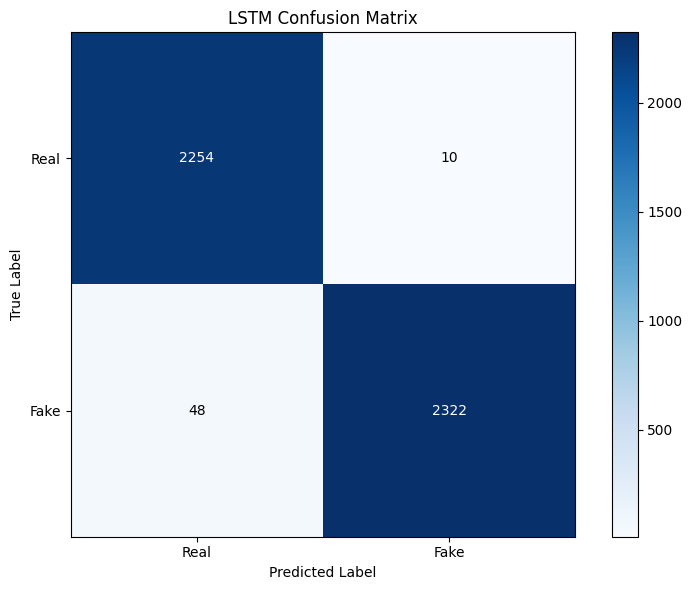

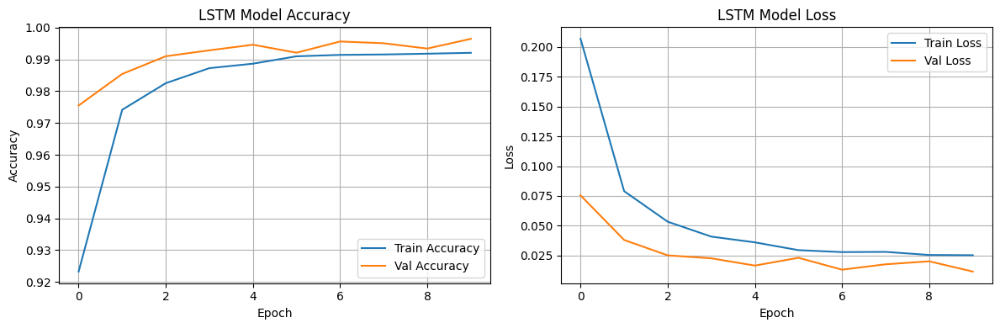


LSTM model saved as 'original_enhanced_lstm_model.keras'
Training completed successfully!


In [1]:
import os
import librosa
import numpy as np
import hashlib
import matplotlib.pyplot as plt
from tqdm import tqdm
import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D, BatchNormalization
from tensorflow.keras.layers import LSTM, Input, Activation, GlobalAveragePooling2D, Bidirectional
from tensorflow.keras.applications import VGG16
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import pandas as pd

# Preprocessing functions
def compute_md5(file_path):
    with open(file_path, 'rb') as f:
        return hashlib.md5(f.read()).hexdigest()

def load_and_pad(file_path, sr=16000):
    try:
        y, _ = librosa.load(file_path, sr=sr)
        if len(y) < sr:
            y = np.pad(y, (0, sr - len(y)))
        return y
    except:
        return None

def preprocess_audio_dir(base_path):
    all_audio = []
    all_labels = []
    seen_hashes = set()
    for label_name in ['real', 'fake']:
        label_dir = os.path.join(base_path, label_name)
        label = 0 if label_name == 'real' else 1
        for file in tqdm(os.listdir(label_dir), desc=f"Processing {label_name}"):
            path = os.path.join(label_dir, file)
            if os.path.getsize(path) == 0:
                continue
            file_hash = compute_md5(path)
            if file_hash in seen_hashes:
                continue
            seen_hashes.add(file_hash)
            y = load_and_pad(path)
            if y is None:
                continue
            all_audio.append(y)
            all_labels.append(label)
    return all_audio, all_labels

def extract_mel_spectrograms(audio_list, sr=16000, n_mels=128, n_fft=2048, hop_length=512):
    """Extract mel-spectrograms with better parameters"""
    spectrograms = []
    for y in tqdm(audio_list, desc="Extracting Mel-Spectrograms"):
        mel_spec = librosa.feature.melspectrogram(
            y=y, 
            sr=sr, 
            n_mels=n_mels,
            n_fft=n_fft,
            hop_length=hop_length,
            fmax=8000
        )
        
        mel_spec_db = librosa.power_to_db(mel_spec, ref=np.max)
        mel_spec_db = (mel_spec_db - np.mean(mel_spec_db)) / (np.std(mel_spec_db) + 1e-8)
        
        if mel_spec_db.shape[1] < 128:
            pad_width = 128 - mel_spec_db.shape[1]
            mel_spec_db = np.pad(mel_spec_db, ((0, 0), (0, pad_width)), mode='constant')
        else:
            mel_spec_db = mel_spec_db[:, :128]
        
        spectrograms.append(mel_spec_db)
    
    spectrograms = np.array(spectrograms)
    spectrograms = np.expand_dims(spectrograms, axis=-1)
    return spectrograms

def create_enhanced_lstm_model(input_shape):
    """Enhanced LSTM model with better architecture"""
    lstm_input_shape = (input_shape[1], input_shape[0])
    
    model = Sequential([
        Input(shape=input_shape),
        tf.keras.layers.Reshape(lstm_input_shape),
        Bidirectional(LSTM(256, return_sequences=True, dropout=0.3)),
        BatchNormalization(),
        Bidirectional(LSTM(128, return_sequences=True, dropout=0.3)),
        BatchNormalization(),
        LSTM(64, dropout=0.2),
        BatchNormalization(),
        Dense(128, activation='relu'),
        Dropout(0.5),
        Dense(64, activation='relu'),
        Dropout(0.3),
        Dense(2, activation='softmax')
    ])
    
    return model

def augment_spectrograms(X_train, y_train, augmentation_factor=2):
    """Apply data augmentation to spectrograms"""
    augmented_X = []
    augmented_y = []
    
    for i in range(len(X_train)):
        # Original
        augmented_X.append(X_train[i])
        augmented_y.append(y_train[i])
        
        # Time shifting
        shift = np.random.randint(-10, 10)
        shifted = np.roll(X_train[i], shift, axis=1)
        augmented_X.append(shifted)
        augmented_y.append(y_train[i])
        
        # Add noise
        noise = np.random.normal(0, 0.005, X_train[i].shape)
        noisy = X_train[i] + noise
        augmented_X.append(noisy)
        augmented_y.append(y_train[i])
    
    return np.array(augmented_X), np.array(augmented_y)

# MAIN LSTM TRAINING
print("="*60)
print("LSTM AUDIO DEEPFAKE DETECTION TRAINING")
print("="*60)

# Dataset paths
base_path = os.path.join(os.getcwd(), 'the-fake-or-real-dataset')
dataset_dir = os.path.join(base_path, "for-original", "for-original")

# Load data
train_path = os.path.join(dataset_dir, 'training')
val_path = os.path.join(dataset_dir, 'validation')
test_path = os.path.join(dataset_dir, 'testing')

print("Loading and preprocessing audio data...")
X_train_raw, y_train = preprocess_audio_dir(train_path)
X_val_raw, y_val = preprocess_audio_dir(val_path)
X_test_raw, y_test = preprocess_audio_dir(test_path)

# Extract mel-spectrograms
print("Extracting mel-spectrograms...")
X_train_spectrograms = extract_mel_spectrograms(X_train_raw)
X_val_spectrograms = extract_mel_spectrograms(X_val_raw)
X_test_spectrograms = extract_mel_spectrograms(X_test_raw)

# Apply data augmentation
print("Applying data augmentation...")
X_train_aug, y_train_aug = augment_spectrograms(X_train_spectrograms, y_train)

# Convert labels to categorical
y_train_cat = to_categorical(y_train_aug, num_classes=2)
y_val_cat = to_categorical(y_val, num_classes=2)
y_test_cat = to_categorical(y_test, num_classes=2)

print(f"Training data shape: {X_train_aug.shape}")
print(f"Validation data shape: {X_val_spectrograms.shape}")
print(f"Test data shape: {X_test_spectrograms.shape}")

# Create and compile LSTM model
print("\nCreating Enhanced LSTM model...")
input_shape = X_train_aug.shape[1:]
lstm_model = create_enhanced_lstm_model(input_shape)

lstm_model.compile(
    optimizer=Adam(learning_rate=0.001),
    loss='categorical_crossentropy',
    metrics=['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall()]
)

print(lstm_model.summary())

# Callbacks
reduce_lr = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=3,
    min_lr=1e-7,
    verbose=1
)

checkpoint_lstm = ModelCheckpoint(
    "original_enhanced_lstm_model.keras",
    monitor='val_accuracy',
    save_best_only=True,
    mode='max',
    verbose=1
)

early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=10,
    restore_best_weights=True,
    verbose=1
)

# Train LSTM
print("\nStarting LSTM training...")
lstm_history = lstm_model.fit(
    X_train_aug,
    y_train_cat,
    validation_data=(X_val_spectrograms, y_val_cat),
    epochs=10,
    batch_size=64,
    callbacks=[reduce_lr, checkpoint_lstm, early_stopping],
    verbose=1
)

print("\nLSTM training completed!")

# Evaluate LSTM
print("\nEvaluating LSTM model...")
best_lstm = tf.keras.models.load_model("original_enhanced_lstm_model.keras")
lstm_eval = best_lstm.evaluate(X_test_spectrograms, y_test_cat, verbose=1)

# Get predictions and metrics
lstm_pred = np.argmax(best_lstm.predict(X_test_spectrograms), axis=1)
y_test_classes = np.argmax(y_test_cat, axis=1)
lstm_accuracy = accuracy_score(y_test_classes, lstm_pred)

# Get detailed classification report
lstm_report = classification_report(y_test_classes, lstm_pred, output_dict=True)

print(f"\n{'='*50}")
print("LSTM MODEL RESULTS")
print(f"{'='*50}")
print(f"Test Accuracy: {lstm_accuracy:.4f}")
print(f"Precision: {lstm_report['weighted avg']['precision']:.4f}")
print(f"Recall: {lstm_report['weighted avg']['recall']:.4f}")
print(f"F1-Score: {lstm_report['weighted avg']['f1-score']:.4f}")

# Plot confusion matrix
plt.figure(figsize=(8, 6))
lstm_cm = confusion_matrix(y_test_classes, lstm_pred)
plt.imshow(lstm_cm, cmap='Blues')
plt.title('LSTM Confusion Matrix')
plt.colorbar()
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.xticks([0, 1], ['Real', 'Fake'])
plt.yticks([0, 1], ['Real', 'Fake'])

for i in range(2):
    for j in range(2):
        plt.text(j, i, f"{lstm_cm[i, j]}", ha='center', va='center',
                color='white' if lstm_cm[i, j] > lstm_cm.max()/2 else 'black')

plt.tight_layout()
plt.show()

# Plot training history
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(lstm_history.history['accuracy'], label='Train Accuracy')
plt.plot(lstm_history.history['val_accuracy'], label='Val Accuracy')
plt.title('LSTM Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)

plt.subplot(1, 2, 2)
plt.plot(lstm_history.history['loss'], label='Train Loss')
plt.plot(lstm_history.history['val_loss'], label='Val Loss')
plt.title('LSTM Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

print("\nLSTM model saved as 'original_enhanced_lstm_model.keras'")
print("Training completed successfully!")